In [6]:
import numpy as np
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import sys
import os
sys.path.append("..")

In [2]:
dataset_name = 'GCB'
sample_name = 'CtcfWT29'
model_type = 'DynaVelo'
num_hidden = 200
zx_dim = 50
zy_dim = 50
k_z0 = 1000
k_t = 1000
k_velocity = 10000
k_consistency = 10000
seed = 0

model_suffix = f'{dataset_name}_{sample_name}_{model_type}_num_hidden_{num_hidden}_zxdim_{zx_dim}_zydim_{zy_dim}_k_z0_{str(k_z0)}_k_t_{str(k_t)}_k_velocity_{str(k_velocity)}_k_consistency_{str(k_consistency)}_seed_{seed}'

# load predicted RNA
adata_rna_pred = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_rna/predicted/RNA_Matrix_Pred_{model_suffix}.h5ad")

# load predicted ATAC
adata_atac_pred = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_atac/MotifMatrix/predicted/Motif_Matrix_Pred_{model_suffix}.h5ad")

# check if the cell names are the same
assert all(adata_rna_pred.obs_names == adata_atac_pred.obs_names)

In [3]:
adata_atac_pred.obs['final.celltype'] = pd.Categorical(adata_atac_pred.obs['final.celltype'], categories=['Centroblast', 'Transitioning', 'Centrocyte', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred.obs['fine.celltype'] = pd.Categorical(adata_atac_pred.obs['fine.celltype'], categories=['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling', 'CC_Rec', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred.uns['final.celltype_colors'] = ['#74c476', '#9ecae1', '#3182bd', '#1be7ff', '#e2a0ff']
adata_atac_pred.uns['fine.celltype_colors'] = ['#deebf7', '#9ecae1', '#3182bd', '#edf8e9', '#bae4b3', '#74c476', '#238b45', '#d94701', '#fd8d3c', '#1be7ff', '#e2a0ff']

adata_rna_pred.obs['final.celltype'] = adata_atac_pred.obs['final.celltype']
adata_rna_pred.obs['fine.celltype'] = adata_atac_pred.obs['fine.celltype']
adata_rna_pred.uns['final.celltype_colors'] = adata_atac_pred.uns['final.celltype_colors']
adata_rna_pred.uns['fine.celltype_colors'] = adata_atac_pred.uns['fine.celltype_colors']

In [4]:
TFs = adata_atac_pred.var_names
adata_rna_pred_TF = adata_rna_pred[:, TFs]

adata_rna_pred_CB = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]
adata_atac_pred_CB = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]

adata_rna_pred_PB = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]
adata_atac_pred_PB = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]

adata_rna_pred_PM = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]
adata_atac_pred_PM = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]

#### Fig 3A

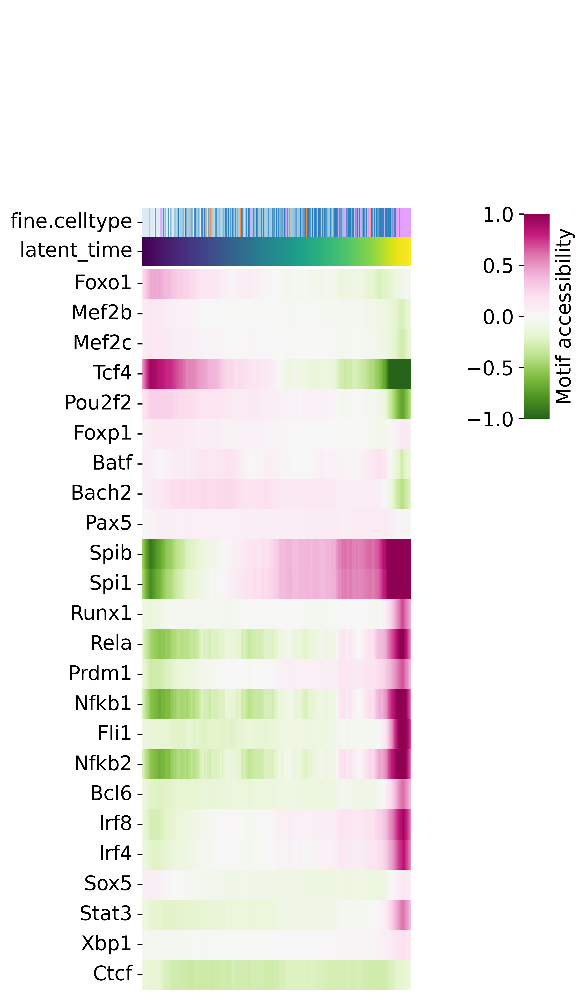

In [9]:
fig_dir = f'../figures/Fig3'
if not os.path.exists(fig_dir):
    os.makedirs(fig_dir)

sc.set_figure_params(vector_friendly=True, dpi_save=300, dpi=300)

tfs_to_plot = ['ARID1A', 'CTCF', 'POU2AF1', 'POU2F2', 'BCL6', 'IRF8', 'FOXO1', 'FOXP1', 'SPI1', 'SPIB', 'CREBBP', 'PRDM1', 'BATF', 'BCOR', 'TOX', 'PAX5', 'BACH2', 'MEF2B', 'MEF2C', 'NFKB1', 'NFKB2', 'STAT3', 'NOTCH2', 'RELA', 'NSD2', 'HHEX', 'XBP1', 'IRF4', 'MYC', 'TCF4', 'Fli1', 'Runx1', 'SOX5']
tfs_to_plot = [g.capitalize() for g in tfs_to_plot]
tfs_to_plot = list(np.intersect1d(TFs, tfs_to_plot))

data = adata_atac_pred_PM[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_PM.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_PM.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_PM.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

idx = np.argsort(data_sorted.values.argmax(1))
data_sorted = data_sorted.iloc[idx]
tfs_to_plot = data_sorted.index

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_PM.pdf', bbox_inches="tight")

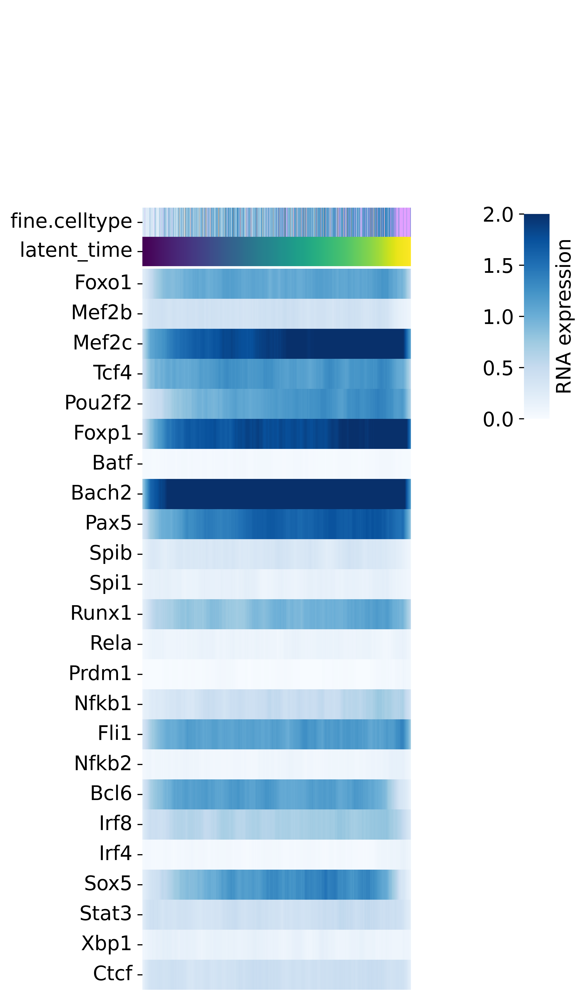

In [10]:
data = adata_rna_pred_PM[:, tfs_to_plot].to_df()
annotations = adata_rna_pred_PM.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_rna_pred_PM.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_rna_pred_PM.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth=200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='Blues',
    xticklabels=False,
    vmax=2,
    vmin=0,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('RNA expression')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/rna_expression_heatmap_tfs_sub_PM.pdf', bbox_inches="tight")

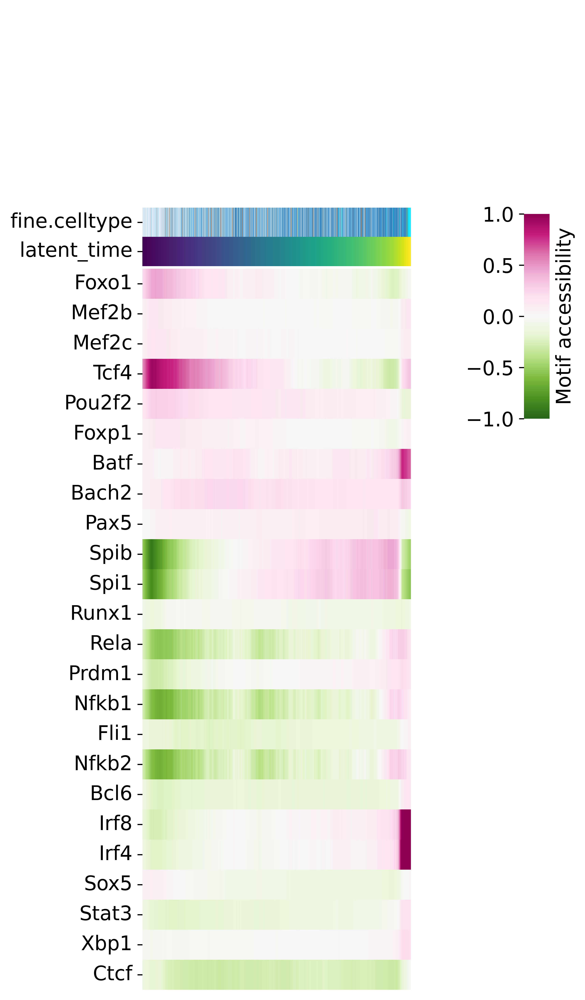

In [11]:
data = adata_atac_pred_PB[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_PB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_PB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_PB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_PB.pdf', bbox_inches="tight")

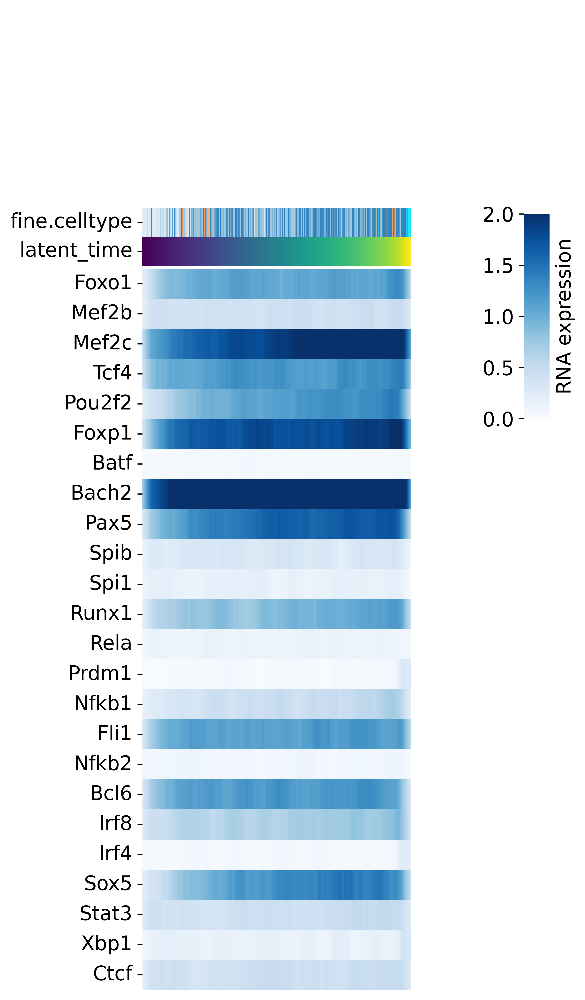

In [12]:
data = adata_rna_pred_PB[:, tfs_to_plot].to_df()
annotations = adata_rna_pred_PB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_rna_pred_PB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_rna_pred_PB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='Blues',
    xticklabels=False,
    vmax=2,
    vmin=0,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('RNA expression')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/rna_expression_heatmap_tfs_sub_PB.pdf', bbox_inches="tight")

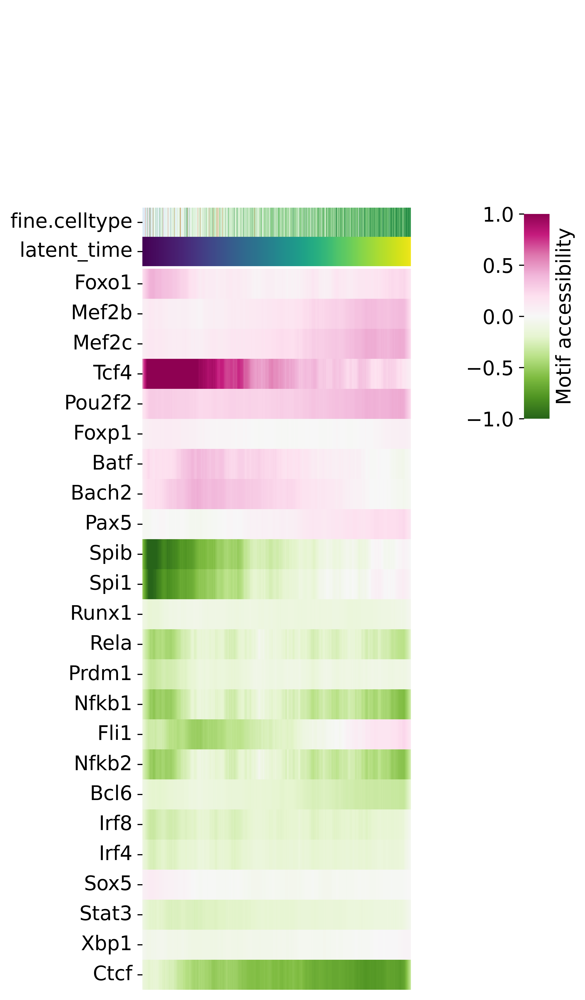

In [13]:
data = adata_atac_pred_CB[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_CB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_CB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_CB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_CB.pdf', bbox_inches="tight")

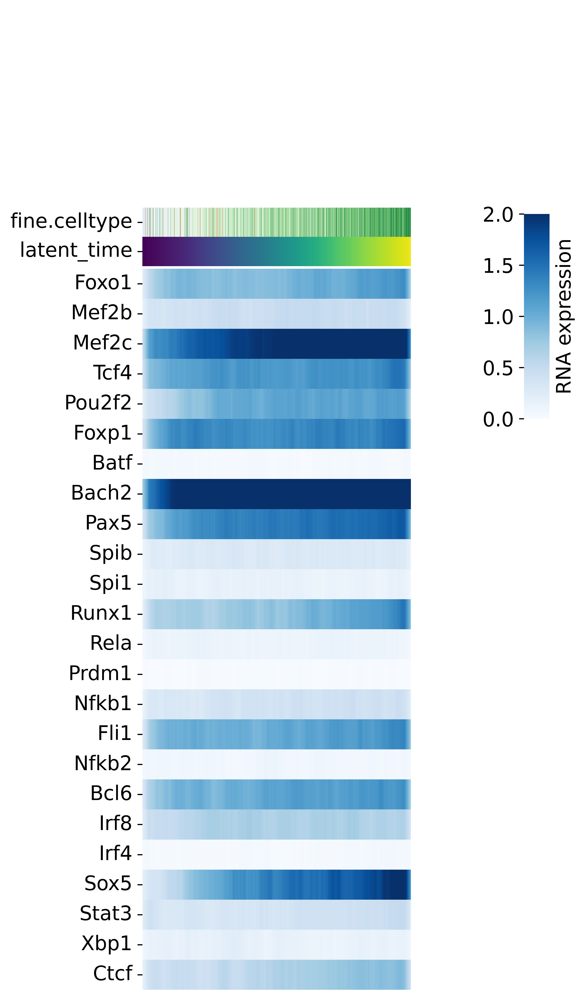

In [14]:
data = adata_rna_pred_CB[:, tfs_to_plot].to_df()
annotations = adata_rna_pred_CB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_rna_pred_CB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_rna_pred_CB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='Blues',
    xticklabels=False,
    vmax=2,
    vmin=0,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('RNA expression')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/rna_expression_heatmap_tfs_sub_CB.pdf', bbox_inches="tight")

#### Fig3B

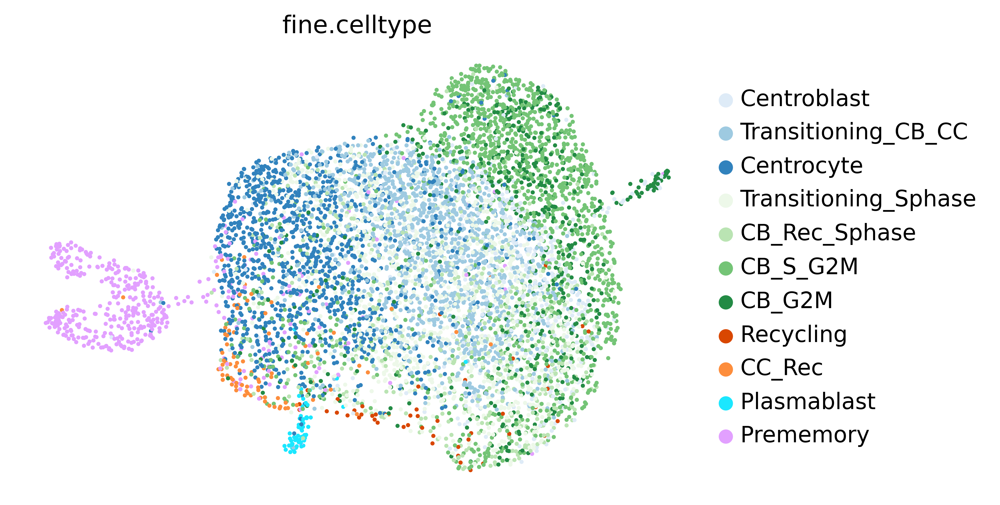

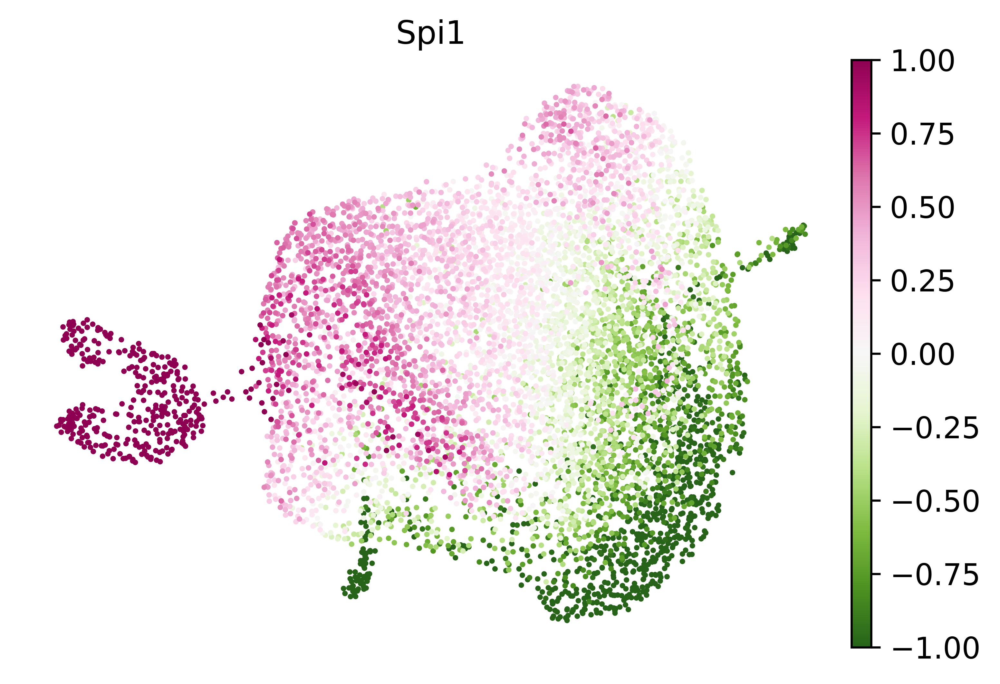

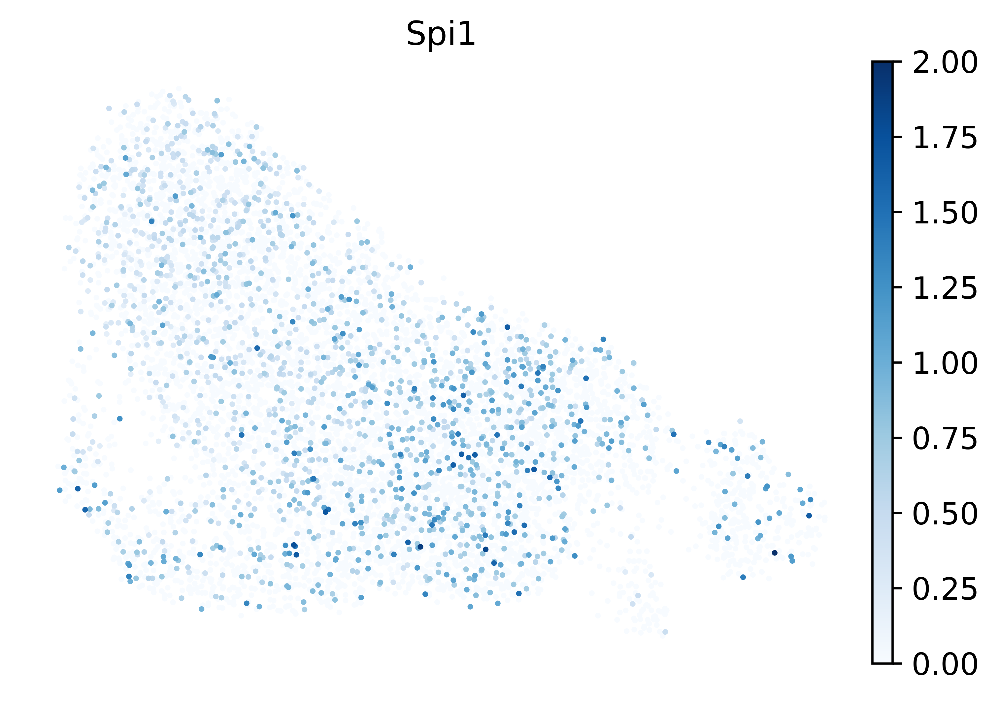

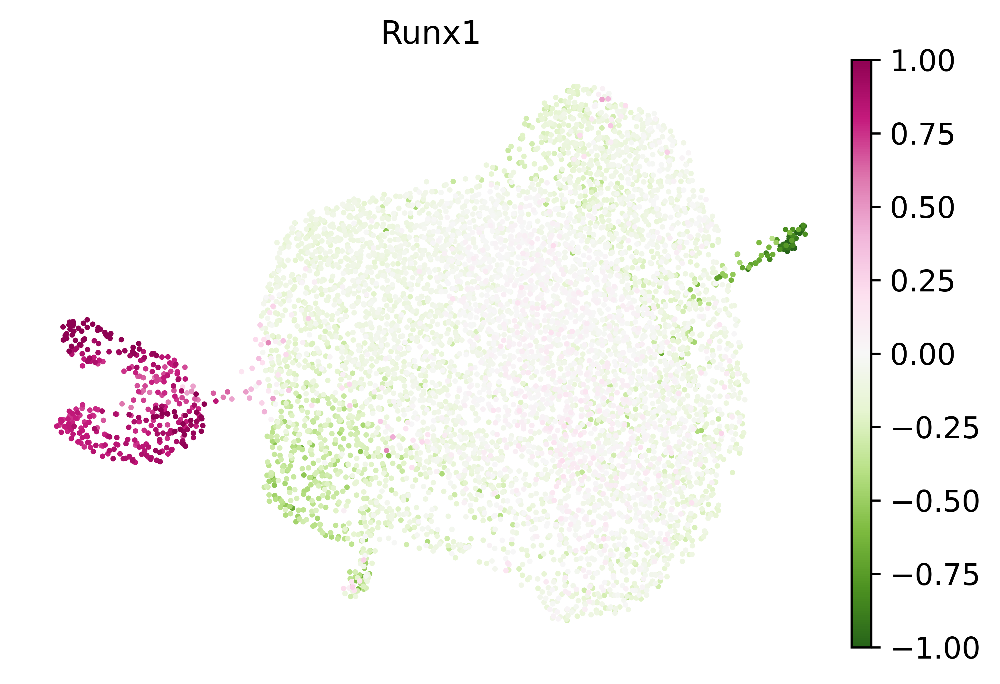

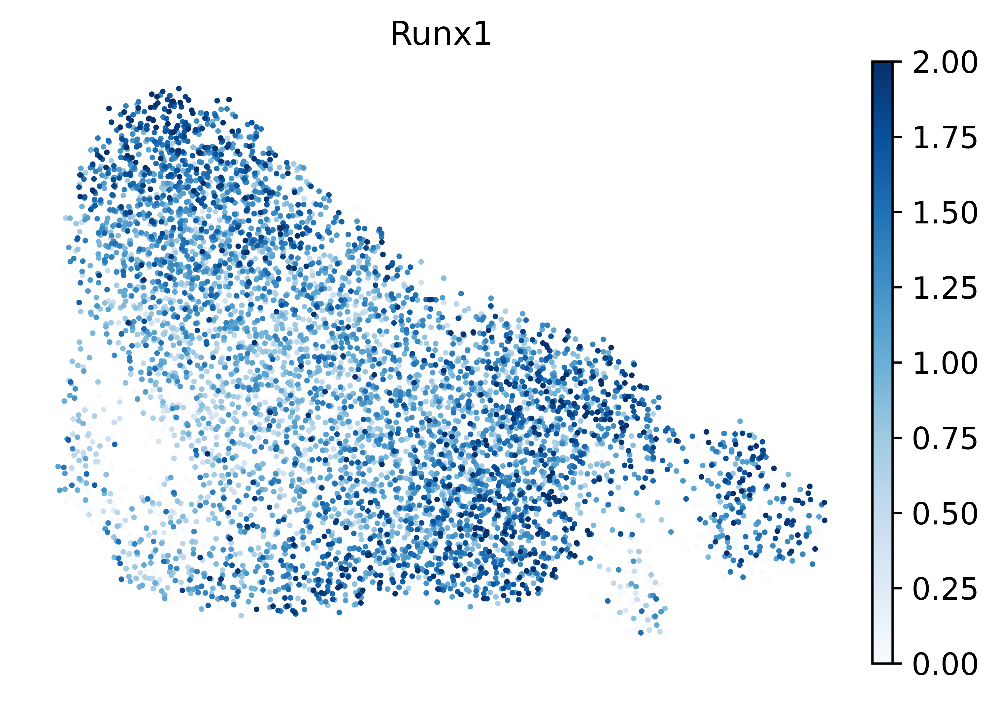

...

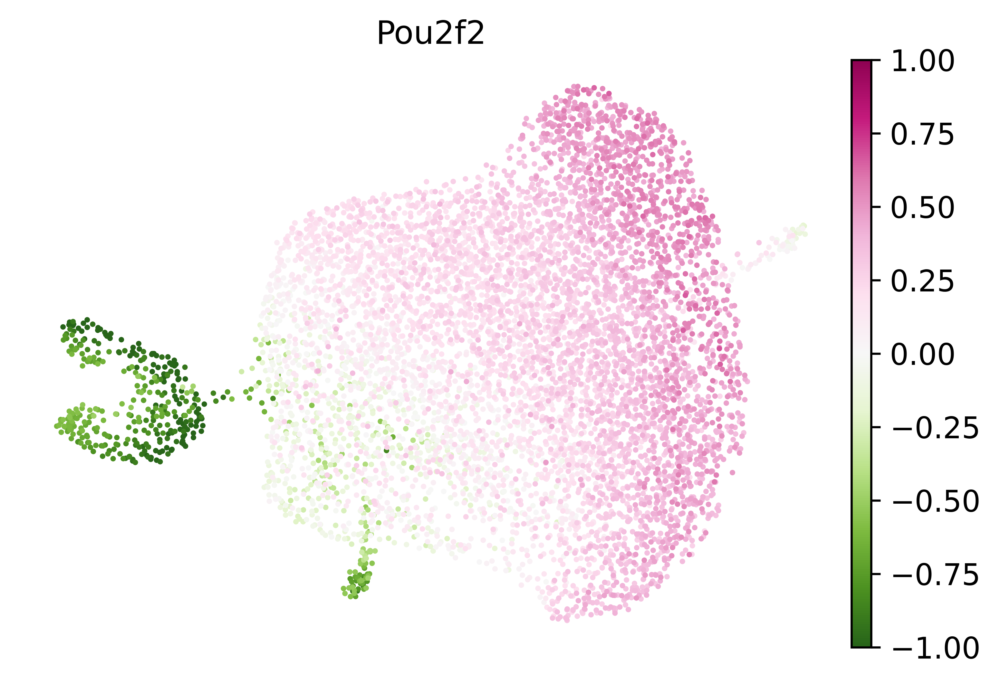

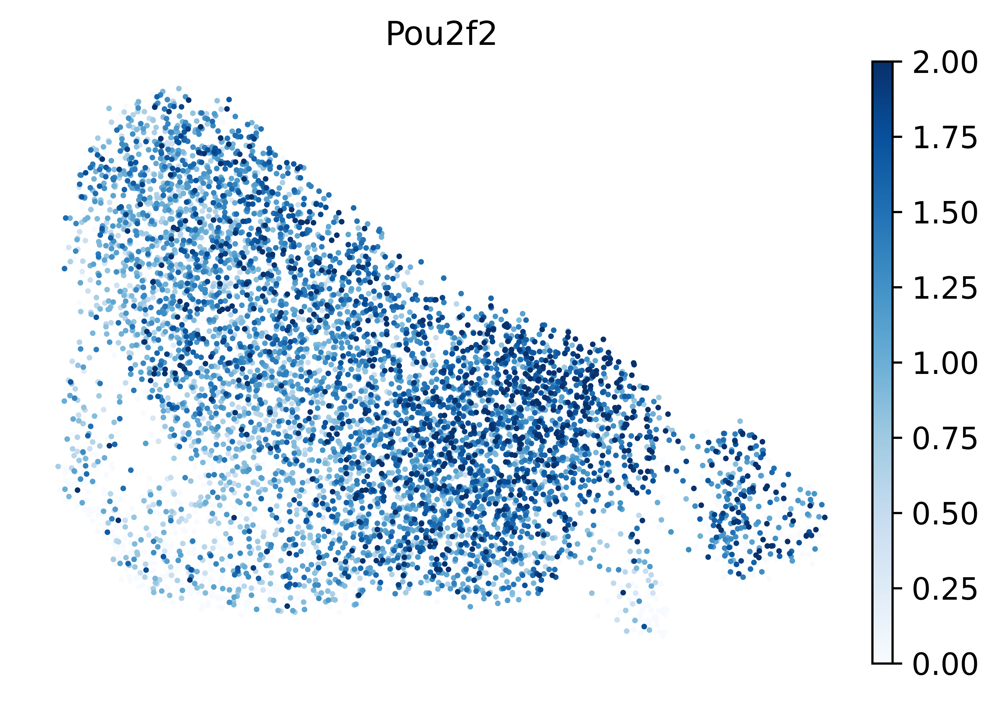

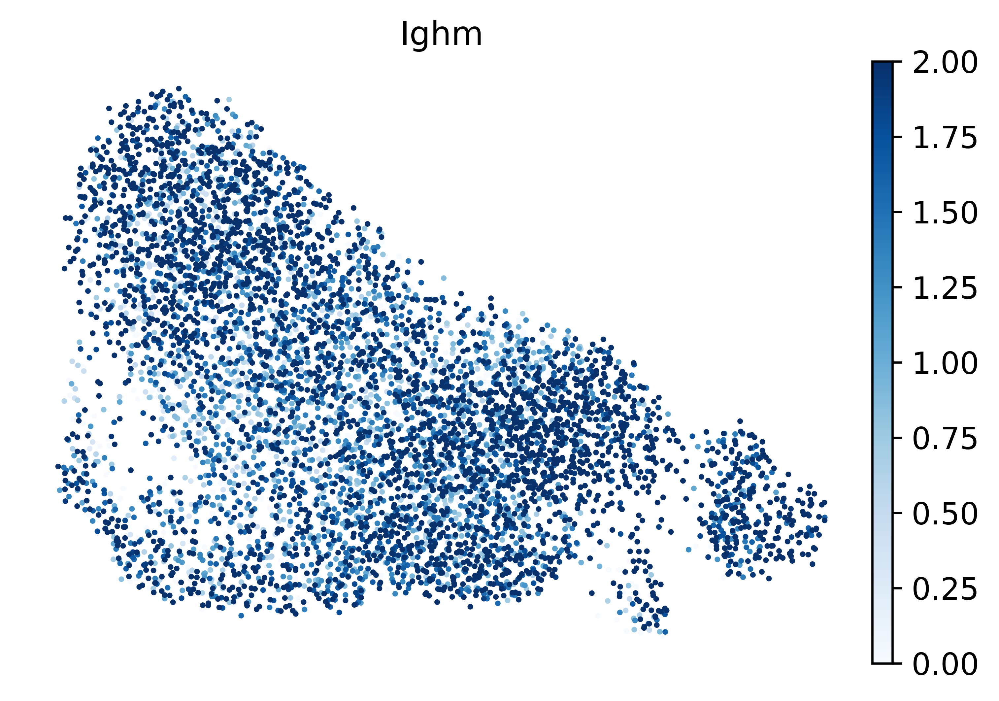

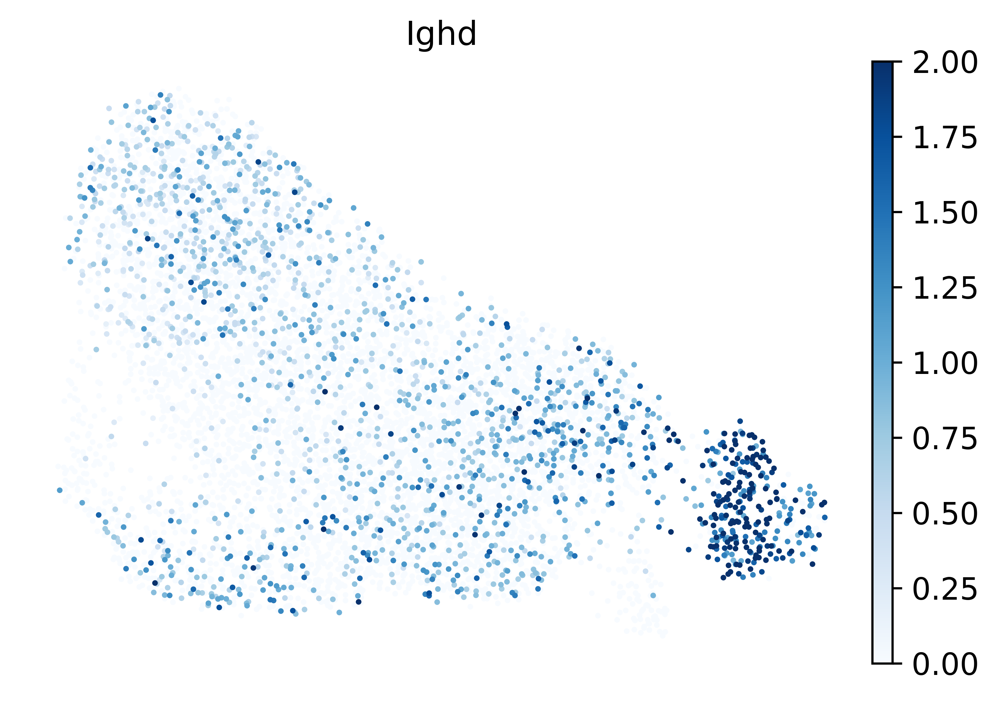

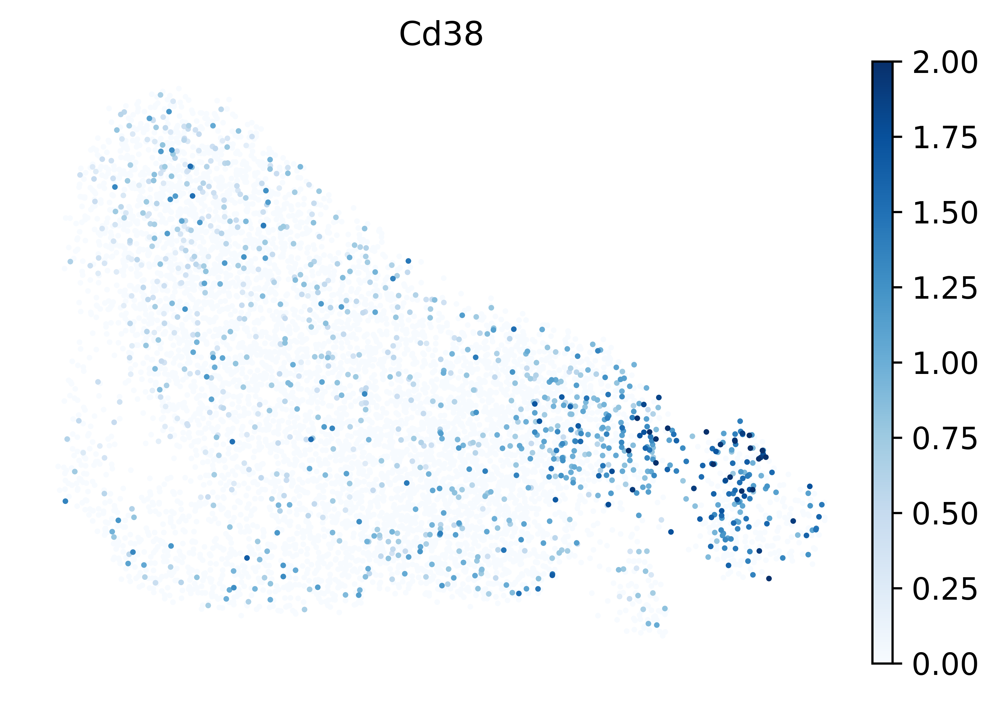

In [16]:
import scvelo as scv
scv.set_figure_params(vector_friendly=True, dpi_save=300, dpi=300)

sc.pp.neighbors(adata_atac_pred, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred, min_dist=1, spread=1, random_state=0, n_components=2)
sc.pl.umap(adata_atac_pred, color='fine.celltype', show=False, frameon=False)

for tf in ['Spi1', 'Runx1', 'Prdm1', 'Xbp1', 'Foxo1', 'Pou2f2']:
    sc.pl.umap(adata_atac_pred, color=tf, vcenter=0, vmax=1, vmin=-1, cmap='PiYG_r', show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_motif_{tf}.pdf', bbox_inches="tight")
    plt.close()

    sc.pl.umap(adata_rna_pred, color=tf, vmax=2, vmin=0, cmap='Blues', use_raw=False, show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_rna_{tf}.pdf', bbox_inches="tight")
    plt.close()

for gene in ['Ighm', 'Ighd', 'Cd38']:
    sc.pl.umap(adata_rna_pred, color=gene, vmax=2, vmin=0, cmap='Blues', use_raw=False, show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_rna_{gene}.pdf', bbox_inches="tight")
    plt.close()